In [152]:
import sys
import tensorflow as tf
import h5py, os, yaml
import umap.umap_ as umap
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
# !pip install https://github.com/p-koo/tfomics/tarball/master
import tfomics
from test_to_bw_fast import read_model, get_config
import pandas as pd
import matplotlib.patches as patches
from tensorflow import keras
import plotly.express as px
import tfr_evaluate, util
import subprocess

In [2]:
class Explainer():
  """wrapper class for attribution maps"""

  def __init__(self, model, class_index=None, func=tf.math.reduce_mean):

    self.model = model
    self.class_index = class_index
    self.func = func

  def saliency_maps(self, X, batch_size=128):
    
    return function_batch(X, saliency_map, batch_size, model=self.model, 
                          class_index=self.class_index, func=self.func) 

@tf.function
def saliency_map(X, model, class_index=None, func=tf.math.reduce_mean):
  """fast function to generate saliency maps"""
  if not tf.is_tensor(X):
    X = tf.Variable(X)

  with tf.GradientTape() as tape:
    tape.watch(X)
    outputs = tf.math.reduce_mean(model(X)[:,:,class_index], axis=1)
  return tape.gradient(outputs, X)


def function_batch(X, fun, batch_size=128, **kwargs):
  """ run a function in batches """

  dataset = tf.data.Dataset.from_tensor_slices(X)
  outputs = []
  for x in dataset.batch(batch_size):
    outputs.append(fun(x, **kwargs))
  return np.concatenate(outputs, axis=0)





def plot_embedding(embedding, cluster_index):
  fig = plt.figure(figsize=[10,10]) 
  sns.scatterplot(
      x=embedding[:, 1],
      y=embedding[:, 0],
      alpha=0.2
  )

  sns.scatterplot(
      x=embedding[cluster_index, 1],
      y=embedding[cluster_index, 0],
      alpha=1
  )
  

def plot_embedding_with_box(embedding, anchors, w=1.2, h=1.5, colors = ['r', 'g', 'b']):
  fig, ax = plt.subplots(1,1,figsize=[10,10]) 
  plt.rcParams.update({'font.size': 18})
  sns.scatterplot(
      x=embedding[:, 1],
      y=embedding[:, 0],
      hue=txt_lab,
      alpha=0.2,
      ax=ax
      )
  plt.legend(frameon=False)
#   plt.title('UMAP projections')
  cluster_index_list = []
  for a, anchor in enumerate(anchors):
    rect = patches.Rectangle(anchor, w, h, linewidth=3, edgecolor=colors[a], facecolor='none')
    ax.add_patch(rect)
    cluster_index = np.argwhere((anchor[0]<embedding[:, 1]) & 
                                ((anchor[0]+w)>embedding[:, 1]) & 
                                (anchor[1]<embedding[:, 0]) & 
                                ((anchor[1]+h)>embedding[:, 0])).flatten()
    cluster_index_list.append(cluster_index)
  plt.savefig('plots/UMAP/UMAP.svg')
  return cluster_index_list

def plot_profiles(pred, cluster_index, class_index=8, bin_size=1, color_edge='k', file_prefix='out'):
  fig, ax = plt.subplots(1,1, figsize=[10, 6])
  p = pred[cluster_index,:,class_index]
  ax.plot(np.repeat(p, bin_size, 1).T, alpha=0.4);
  # Set the borders to a given color...
  #     ax.tick_params(color=color_edge, labelcolor='green')
#   for spine in ax.spines.values():
#     spine.set_edgecolor(color_edge)
#     spine.set_linewidth(3)
#   plt.savefig('plots/UMAP/{}_coverage.svg'.format(file_prefix))


def plot_saliency_values(saliency_scores, X_sample, file_prefix='out'):
  fig, ax = plt.subplots(1,1, figsize=[10, 6])
#   fig = plt.figure(figsize=(20,2))
  for i in range(len(saliency_scores)):
    grad_times_input = np.sum(saliency_scores[i]*X_sample[i], axis=1)
    plt.plot(grad_times_input, alpha=0.4)
#   for spine in ax.spines.values():
#     spine.set_edgecolor(color_edge)
#     spine.set_linewidth(3)
#   plt.savefig('plots/UMAP/{}_{}_saliency.svg'.format(file_prefix, len(saliency_scores)))


def plot_saliency_logos(saliency_scores, X_sample, window=20, num_plot=25):
  L = X_sample.shape[1]

#   fig = plt.figure(figsize=(20,22))
  for i in range(len(saliency_scores)):
#   for i in [6, 14, 58, 65, 78]:
    fig, ax = plt.subplots(1,1,figsize=[20, 1])
    x_sample = np.expand_dims(X_sample[i], axis=0)
    scores = np.expand_dims(saliency_scores[i], axis=0)

    # find window to plot saliency maps (about max saliency value)
    index = np.argmax(np.max(np.abs(scores), axis=2), axis=1)[0]
    if index - window < 0:
      start = 0
      end = window*2+1
    elif index + window > L:
      start = L - window*2 - 1
      end = L
    else:
      start = index - window
      end = index + window

    saliency_df = tfomics.impress.grad_times_input_to_df(x_sample[:,start:end,:], scores[:,start:end,:])

#     ax = plt.subplot(num_plot,1,i+1)
    tfomics.impress.plot_attribution_map(saliency_df, ax, figsize=(20,1))
    ax.set_title(i)
#     plt.savefig('plots/UMAP/saliency_plots/{}.svg'.format(i))
  plt.tight_layout()


In [17]:
testset, targets = tfr_evaluate.collect_whole_testset(coords=True, batch_size=128)

In [187]:
def get_cell_line_overlaps(cell_line):
    cmd = 'bedtools intersect -f 0.5 -wa -a /home/shush/profile/QuantPred/datasets/chr8/complete/random_chop/i_2048_w_1/sequences.bed -b /home/shush/profile/QuantPred/datasets/cell_line_specific_test_sets/cell_line_{}/complete/peak_centered/i_2048_w_1.bed | uniq > chr8_cell_line_{}_IDR.bed'.format(cell_line, cell_line)
    process = subprocess.Popen(cmd, stdout=subprocess.PIPE, shell=True)
    output, error = process.communicate()
    df = pd.read_csv('chr8_cell_line_{}_IDR.bed'.format(cell_line), sep='\t', header=None)
    idr_starts = df.iloc[:,1].values
    return idr_starts

In [184]:
run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210705_124947-5lmwz5d3' # 32
layer_dict = {15:'residual block 1', 22:'residual block 2', 24:'last conv layer', 25:'BN before dense'}
model, bin_size = read_model(run_path, compile_model=False)

aux_model_list = []
LAYER_NUMBERS = [15, 22, 24, 25]
aux_model_list = [tf.keras.Model(inputs=model.inputs,
                           outputs=model.layers[l].output) for l in LAYER_NUMBERS]

In [ ]:
cell_lines = [8, 13, 4]
multicell_emb = []
for cell_line in cell_lines:
    idr_starts = get_cell_line_overlaps(cell_line)
    threshold = 2

    intermediate_outputs = {l:[] for l in LAYER_NUMBERS}
    idr_class = []
    for C, X, Y in testset:
        above_thresh_idx = np.argwhere(Y.numpy()[:,:,cell_line].max(axis=1)>threshold).flatten()
        filtered_y = Y.numpy()[above_thresh_idx, :,cell_line]
        filtered_x = X.numpy()[above_thresh_idx, :,:]
        filtered_c = C.numpy()[above_thresh_idx]
        for i, (aux_model) in enumerate(aux_model_list):
            interm = aux_model(filtered_x).numpy()
            intermediate_outputs[LAYER_NUMBERS[i]].append(interm)
        idr_class.append([True if int(str(c).strip('\'b').split('_')[1]) in idr_starts else False for c in filtered_c])

    # intermediate_outputs = np.concatenate(intermediate_outputs)
    idr_class = [item for sublist in idr_class for item in sublist]


    dfs_per_layer = []
    for layer, intermediate_output in intermediate_outputs.items():
        intermediate_output = np.concatenate(intermediate_output)
        reducer = umap.UMAP()
        if len(intermediate_output.shape) == 3:
            d1, d2, d3 = intermediate_output.shape
            intermediate_output = intermediate_output.reshape(d1, d2*d3)

        embedding = reducer.fit_transform(intermediate_output)
        df = pd.DataFrame({'UMAP 1':embedding[:,1], 'UMAP 2':embedding[:,0], 'IDR':idr_class})
        df['layer'] = layer_dict[layer]
        dfs_per_layer.append(df)

    combined_embeddings = pd.concat(dfs_per_layer)
    combined_embeddings['cell line'] = targets[cell_line]
    multicell_emb.append(combined_embeddings)

In [ ]:
plt.figure(figsize=[30,20])
plt.rcParams.update({'font.size': 22})

g = sns.FacetGrid(pd.concat(multicell_emb), hue="IDR", row='cell line', col='layer', 
                  height=8, palette=['#f0e442', '#cc79a7']) #'#05F31A'
g.map(sns.scatterplot, "UMAP 1", "UMAP 2", alpha=0.2)
g.add_legend(loc='upper left')
for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [250] 
    
# plt.suptitle(title);
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

In [176]:
np.sum(idr_class)

1673

In [179]:
df['IDR'].sum()

1673

In [180]:
px.scatter(combined_embeddings, x="UMAP 1", y="UMAP 2", animation_frame="layer", 
           color="IDR", opacity=0.2, #hover_name="coords", 
           range_x=[combined_embeddings['UMAP 1'].min(),combined_embeddings['UMAP 1'].max()], 
           range_y=[combined_embeddings['UMAP 2'].min(),combined_embeddings['UMAP 2'].max()],
#            title=describe_run(run_path)
          )

/home/shush/tf_2/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:>

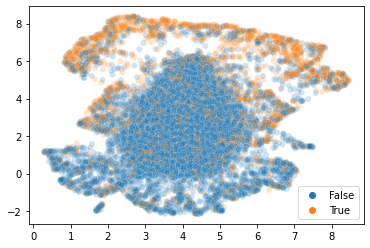

In [107]:
sns.scatterplot(embedding[:,1], embedding[:,0], hue=idr_class, alpha=0.2)


'A549'

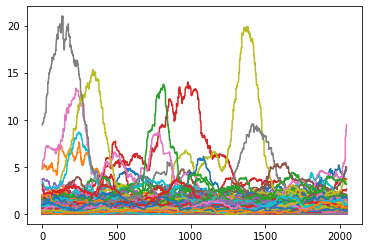

In [23]:
plt.plot(ground_truths.numpy()[:,:,cell_line].T);

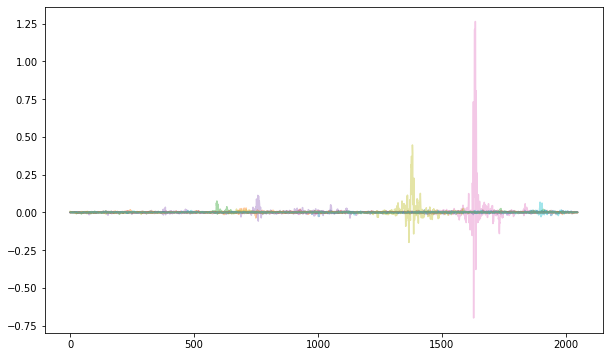

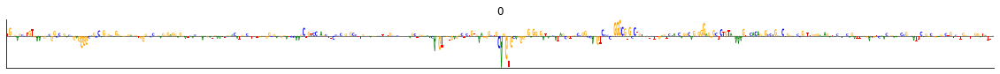

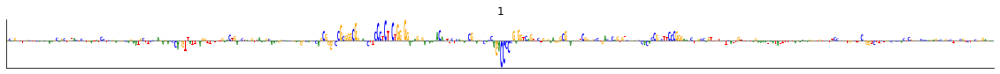

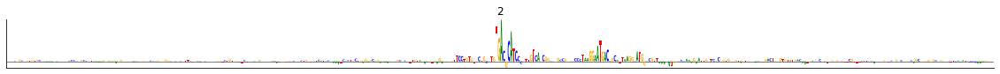

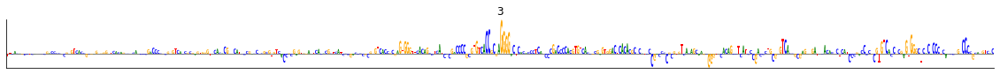

...

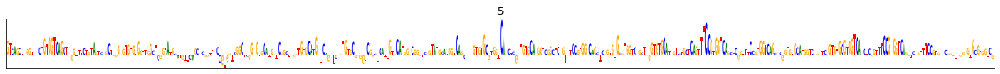

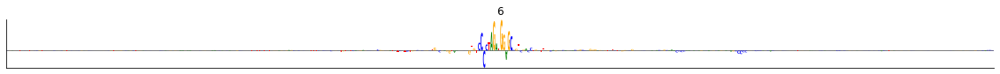

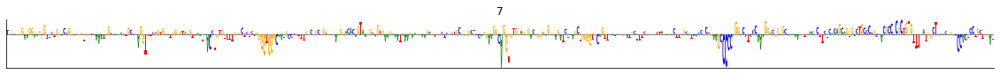

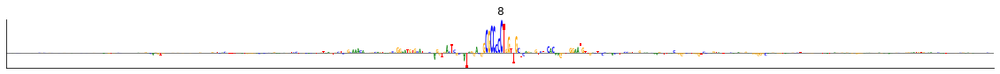

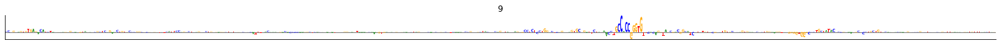

In [26]:
explainer = Explainer(model, class_index=cell_line)
X_sample = seqs[502:,:,:]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)



In [12]:
dataset_dir = '/mnt/1a18a49e-9a31-4dbf-accd-3fb8abbfab2d/shush/4grid_atac/complete/peak_centered/i_2048_w_1/'


In [20]:
sts = util.load_stats(dataset_dir)
testset = util.make_dataset(dataset_dir, 'test', sts, coords=True,
                            batch_size=512, shuffle=False)

In [55]:
peak_summary_path = 'datasets/i_2048_w_1_chr8.bed'
peak_summary = pd.read_csv(peak_summary_path, sep='\t', header=None)
coords = []
peak_labels = []
for i, row in peak_summary.iterrows():
    coords.append('{}_{}_{}'.format(row[0], row[1], row[2]))
    peak_labels.append(row[6])
activity_table = pd.DataFrame({'coords':coords, 'labels':peak_labels})

In [64]:
data_coords = []
for C,_,_ in testset:
    data_coords.append([str(c).strip('b').strip('\'') for c in C.numpy()])
flat_list = [s for sublist in data_coords for s in sublist]

data_coords_df = pd.DataFrame({'coords':flat_list})

In [135]:
data_labels_df = data_coords_df.merge(activity_table, how='left')

In [139]:
bad_idx = np.argwhere((pd.isna(data_labels_df['labels'])).values)

In [3]:
hf = h5py.File('dataset_and_embeddings.h5', 'r')
X = hf['thresh_A549_X'][:] # sequences
Y = hf['thresh_A549_Y'][:] # cell line specific thresholded profiles
hue_idr_mask = hf['hue_idr_mask'][:] # idr peak mask

In [90]:
# run_path_2048 = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210708_054512-6o9aiemr' # 2K
# run_path_512 = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210707_075709-uagtphvc'
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_elzar/run-20210805_225520-4jmi917g' # base resolution basenji
# run_path = '/mnt/906427d6-fddf-41bf-9ec6-c3d0c37e766f/amber/elzar_wandb/run-20210823_113229-cvwwhn2l' # best bpnet from augmentation
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_amber/run-20210804_161352-v3cllxs2' # binned bpnet
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210706_210747-i6y823ij' 

# testset = util.make_dataset(data_dir, 'test', sts, batch_size=512, shuffle=False)
# targets = pd.read_csv(data_dir+'targets.txt', sep='\t')['identifier'].values
run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210705_124947-5lmwz5d3' # 32
model, bin_size = read_model(run_path, compile_model=False)

In [91]:
# basset_run = 'basset/run-20210831_022930-hiln8r84/'
# model = tf.keras.models.load_model(basset_run+'files/model-best.h5')

In [94]:
len(intermediate_outputs.shape)

3

In [95]:
all_layer_embeddings = []
#     LAYER_NUMBER = -3 # model layer to embed
for LAYER_NUMBER in [-3]:
    aux_model = tf.keras.Model(inputs=model.inputs,
                               outputs=model.layers[LAYER_NUMBER].output)
    intermediate_outputs = []
    for C,X,Y in testset:
        interm = aux_model(X).numpy()
        intermediate_outputs.append(interm)
        
        
    intermediate_outputs = np.concatenate(intermediate_outputs)
    reducer = umap.UMAP()
    if len(intermediate_outputs.shape) == 3:
        d1, d2, d3 = intermediate_outputs.shape
        intermediate_outputs = intermediate_outputs.reshape(d1, d2*d3)
        
    embedding = reducer.fit_transform(intermediate_outputs)
    df = pd.DataFrame({'umap 1': embedding[:,0], 'umap 2' : embedding[:,1]})
    df['layer'] = LAYER_NUMBER
#     df['label'] = data_labels_df[]
    all_layer_embeddings.append(df)

In [141]:
class_labels = [l if len(l)==1 else '>1 cell line' for l in data_labels_df['labels']]
# df['cell line'] = class_labels

TypeError: object of type 'float' has no len()

In [7]:
emb = pd.concat(all_layer_embeddings)

In [11]:
px.scatter(emb, x="umap 1", y="umap 2", animation_frame="layer", opacity=0.2)

In [11]:
model.layers[LAYER_NUMBER].output

<tf.Tensor 'activation_12/Identity:0' shape=(None, 1024) dtype=float32>

In [5]:
LAYER_NUMBER = -3 # model layer to embed
dataset = tf.data.Dataset.from_tensor_slices(X)
dataset = dataset.batch(512)
aux_model = tf.keras.Model(inputs=model.inputs,
                           outputs=model.layers[LAYER_NUMBER].output)
intermediate_outputs = []
predictions = []
for tensor in dataset:
    interm = aux_model(tensor).numpy()
    print(interm.shape)
    d1, d2, d3 = interm.shape
    intermediate_outputs.append(interm.reshape(d1, d2*d3))
    predictions.append(model(tensor).numpy())
intermediate_outputs = np.concatenate(intermediate_outputs)
predictions = np.concatenate(predictions)

(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(512, 64, 256)
(18, 64, 256)


In [11]:
# %%time 

reducer = umap.UMAP(min_dist = 0.0001)
embedding = reducer.fit_transform(intermediate_outputs)

In [7]:
# embedding = np.load('embedding_32.npy')

In [14]:
# np.save('embedding_32.npy', embedding)

In [9]:
label_dict = {False:'non-IDR', True:'IDR'}
txt_lab = [label_dict[h] for h in hue_idr_mask]

<AxesSubplot:>

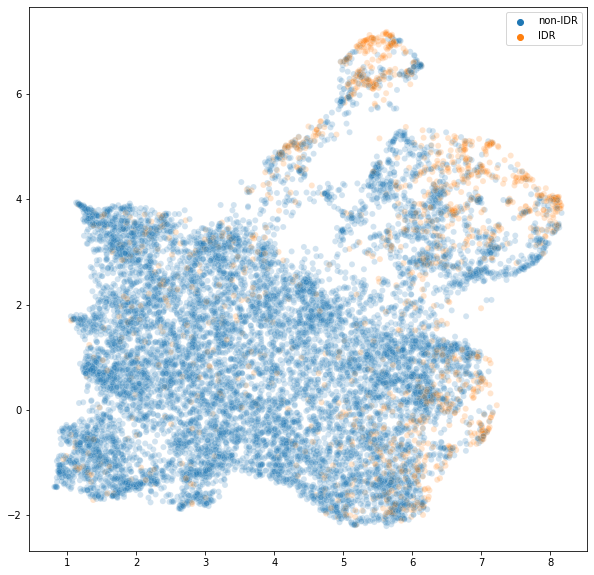

In [12]:
fig = plt.figure(figsize=[10,10]) 
sns.scatterplot(
  x=embedding[:, 1],
  y=embedding[:, 0],
  alpha=0.2, hue=txt_lab
)

# Let's probe embeddings

<AxesSubplot:>

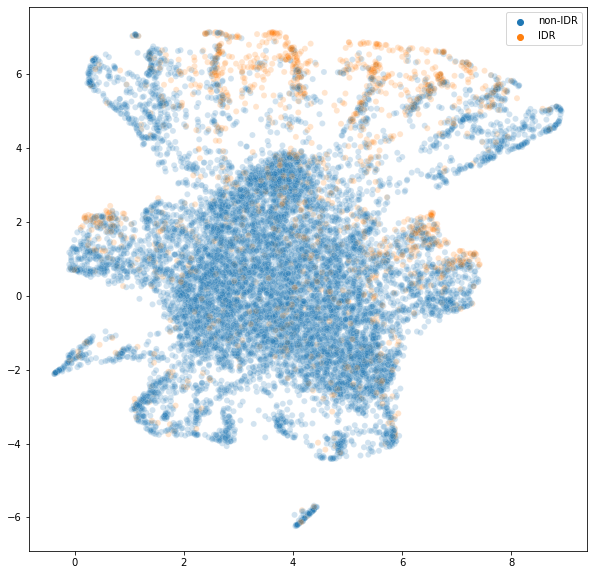

In [10]:
fig = plt.figure(figsize=[10,10]) 
sns.scatterplot(
  x=embedding[:, 1],
  y=embedding[:, 0],
  alpha=0.2, hue=txt_lab
)

In [11]:
x=embedding[:, 0]
y=embedding[:, 1]

class_index= 8
idr_index = np.where(hue_idr_mask)[0]

# create explainer class <-- to run saliency analysis
explainer = Explainer(model, class_index=class_index)

In [12]:
# get model predictions
pred = []
for tensor in dataset:
    pred.append(model(tensor).numpy())
pred = np.concatenate(pred)


# now let's probe different regions

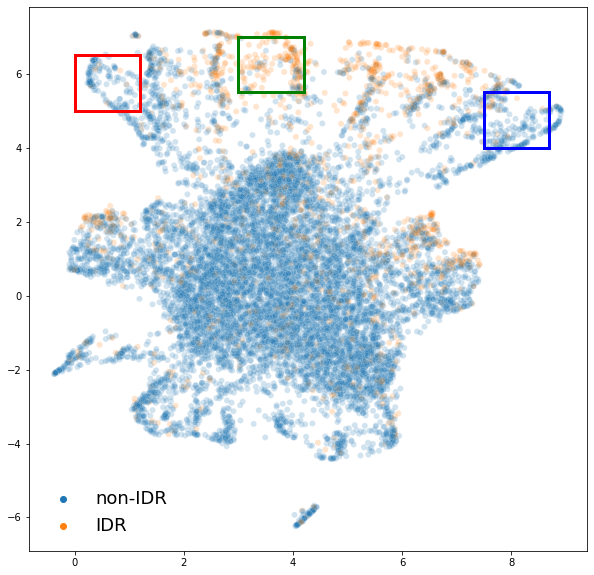

In [13]:
cluster_list = plot_embedding_with_box(embedding, [(0,5), (3,5.5), (7.5,4)]) 
#                                                    (6,0), (3,0), (-0.2,0.7)])

In [33]:
def plot_all(index, color_edge='k', file_prefix='out'):
#     index = np.array(list(set(index).intersection(set(idr_index))))
    if len(index)>50:
        np.random.seed(42)
        print(len(index))
        
        cluster_index = np.random.choice(index, 100, replace=False)
    else:
        cluster_index = index
    
    plot_embedding(embedding, cluster_index)
    class_index = 8
    fig, axs = plt.subplots(1,3, figsize=[15, 3])
    p = pred[cluster_index,:,class_index]
    y = Y[cluster_index, :, 0]

    all_plots = np.concatenate([p.flatten(),y.flatten()])
    y_max = all_plots.max()
    plt.rcParams.update({'font.size': 18})

    axs[0].plot(y.T, alpha=0.4)
    axs[1].plot(np.repeat(p, bin_size, 1).T, alpha=0.4);
    axs[0].set_ylim(0,y_max)
    axs[1].set_ylim(0, y_max)
    axs[0].set_yticks([0,15])
    axs[1].set_yticks([0,15])
    axs[0].set_xlab('')
    # sns.set(font_scale=1.3)  # crazy big
# sns.set_style(style='white')
# plt.rcParams['xtick.major.size'] = 9
# plt.rcParams['xtick.major.width'] = 1

# plt.rcParams['ytick.major.size'] = 9
# plt.rcParams['ytick.major.width'] = 1
# plt.rcParams['xtick.bottom'] = True
# plt.rcParams['ytick.left'] = True
    saliency_scores = explainer.saliency_maps(X[cluster_index])

    # plot raw saliency values
#     plot_saliency_values(saliency_scores, X[cluster_index], color_edge=color_edge, file_prefix=file_prefix)
    for i in range(len(saliency_scores)):
        grad_times_input = np.sum(saliency_scores[i]*X[cluster_index][i], axis=1)
        plt.plot(grad_times_input, alpha=0.4)
#     # plot attribution maps in a narrow range about max saliency value
#     print(saliency_scores.shape)
#     print(X[cluster_index].shape)
#     plot_saliency_logos(saliency_scores, X[cluster_index], window=200, num_plot=1)
#     binned_Y = Y[index, :,0].reshape(index.shape[0], 2048//256, 256).mean(axis=-1)
#     preds = predictions[index, :, 8]
#     pr = []
#     for i,p in enumerate(preds):
#         pr.append(stats.pearsonr(binned_Y[i,:], p)[0])
#     return pr

152
(100, 2048, 4)
(100, 2048, 4)


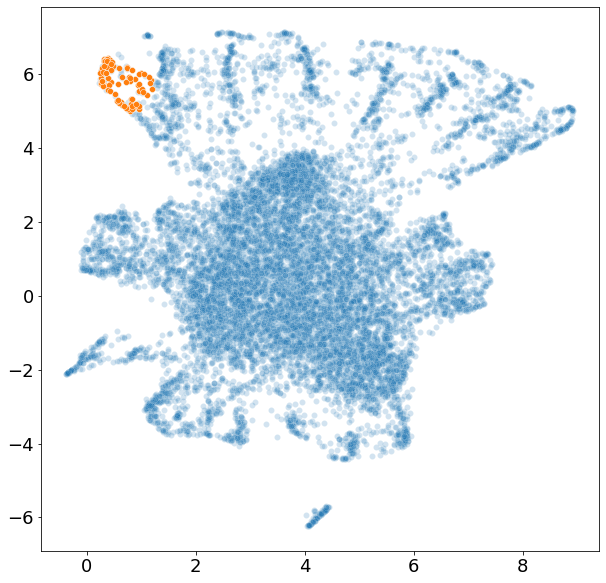

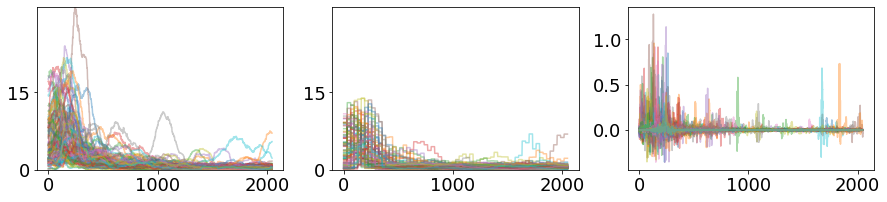

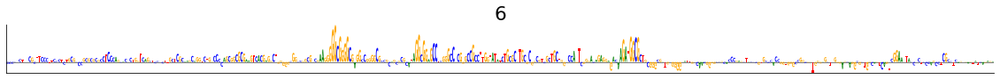

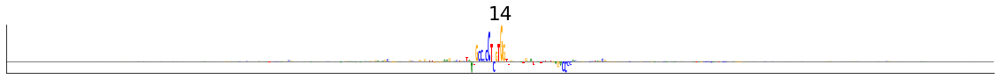

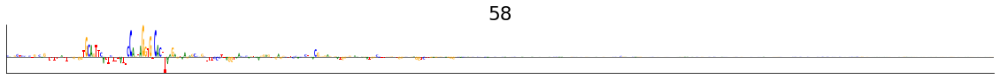

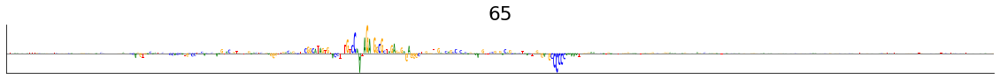

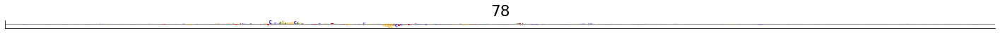

In [34]:
plot_all(cluster_list[0], color_edge='r', file_prefix='0')

# np.nanmean(pr)

186
(100, 2048, 4)
(100, 2048, 4)


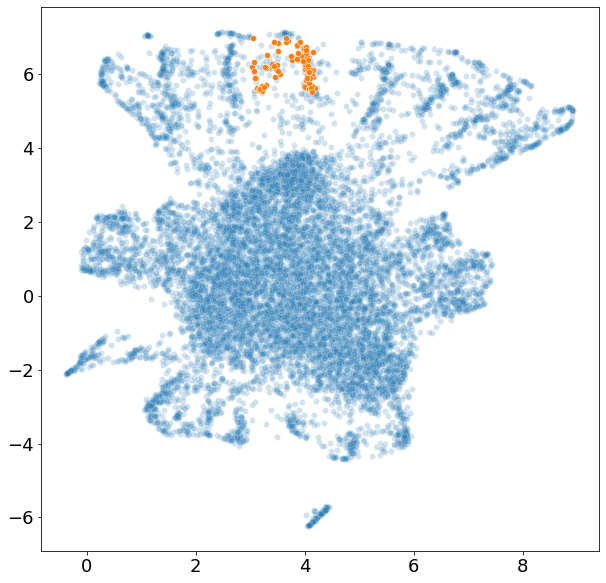

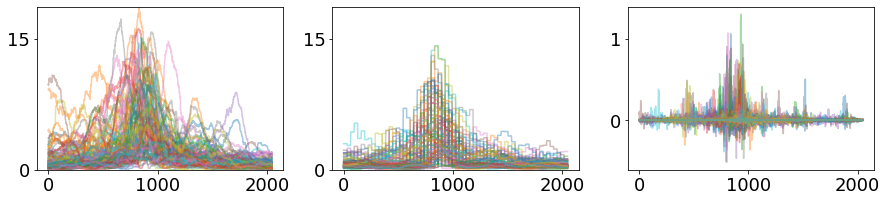

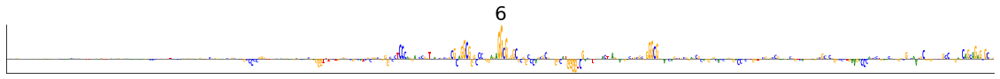

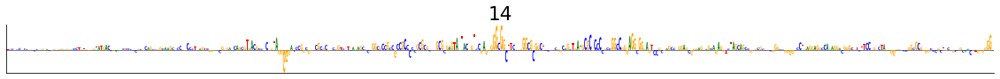

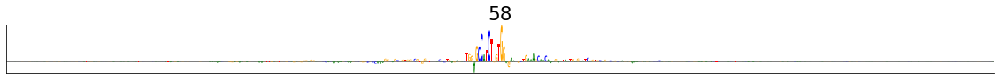

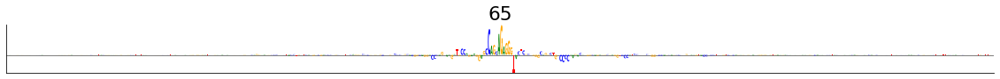

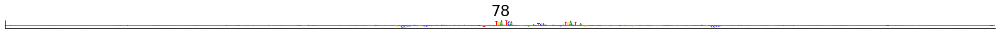

In [35]:

# index = np.where((y >6)&(x < 3)&(x>0))[0]
pr = plot_all(cluster_list[1], color_edge='g', file_prefix='1')


192
(100, 2048, 4)
(100, 2048, 4)


/home/shush/tf_2/lib/python3.7/site-packages/ipykernel_launcher.py:113: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


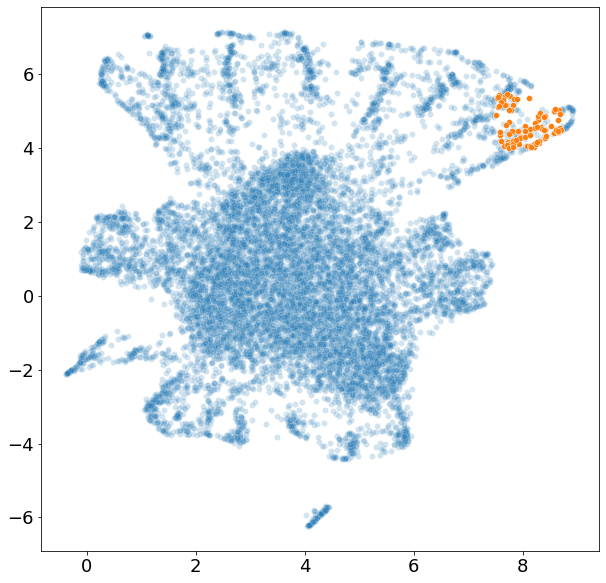

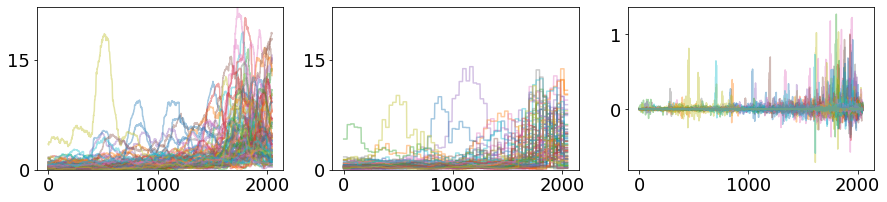

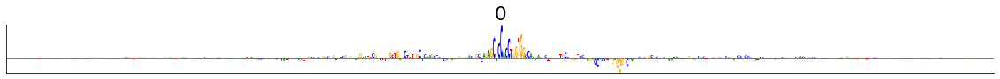

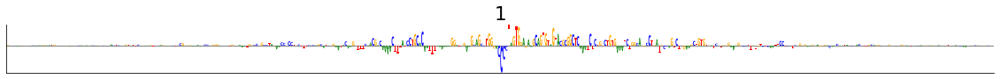

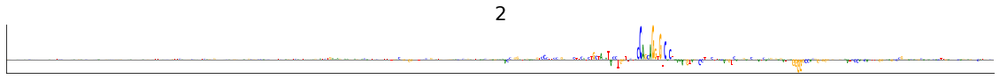

...

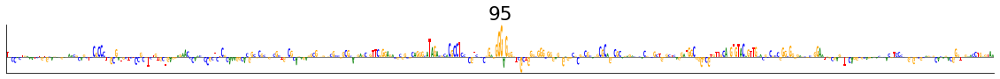

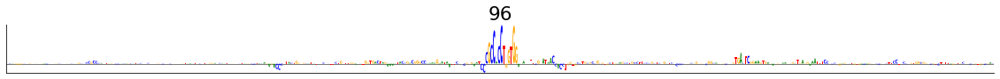

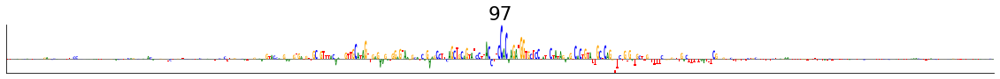

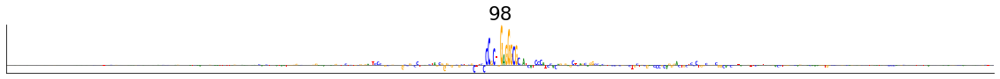

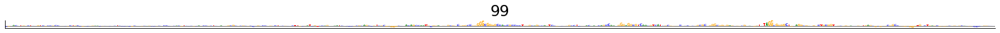

In [38]:
pr = plot_all(cluster_list[2], color_edge='b', file_prefix='2')



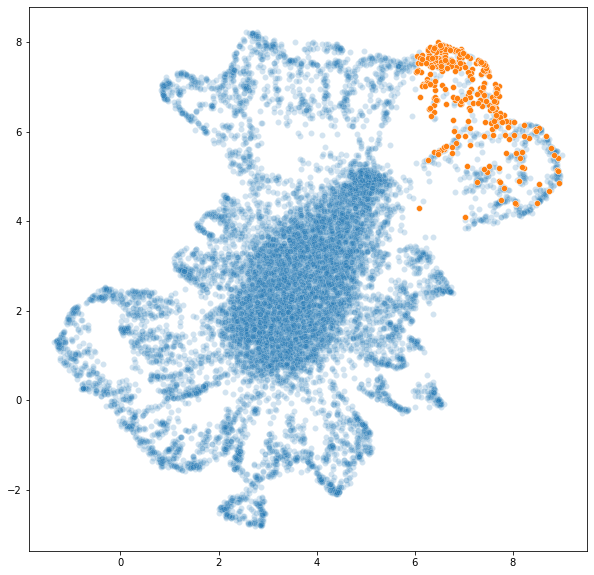

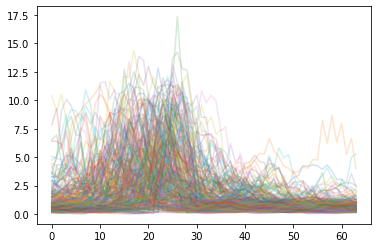

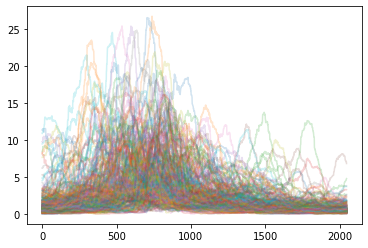

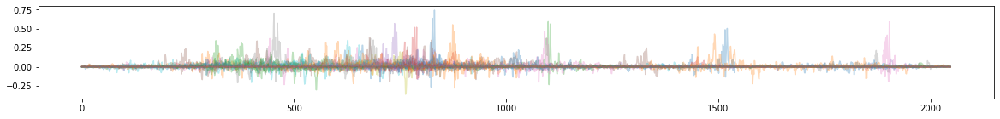

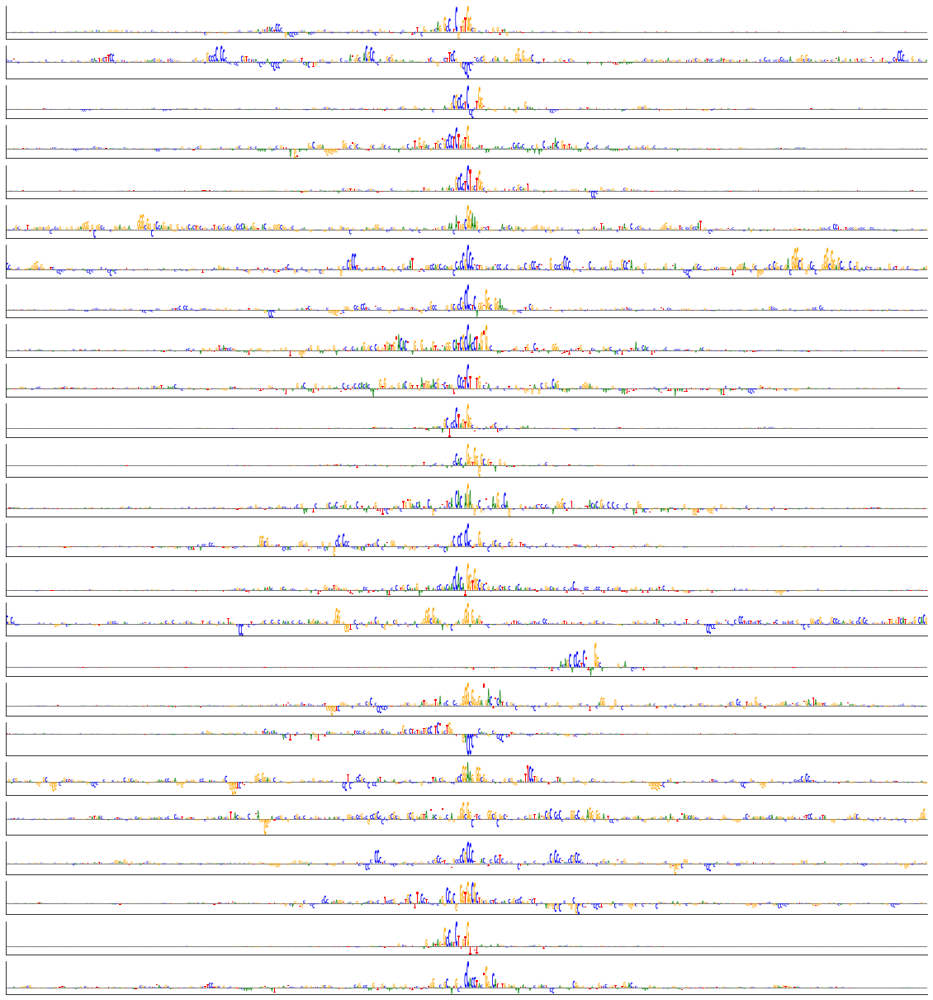

In [ ]:
index = np.where((y >4)&(x > 6))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


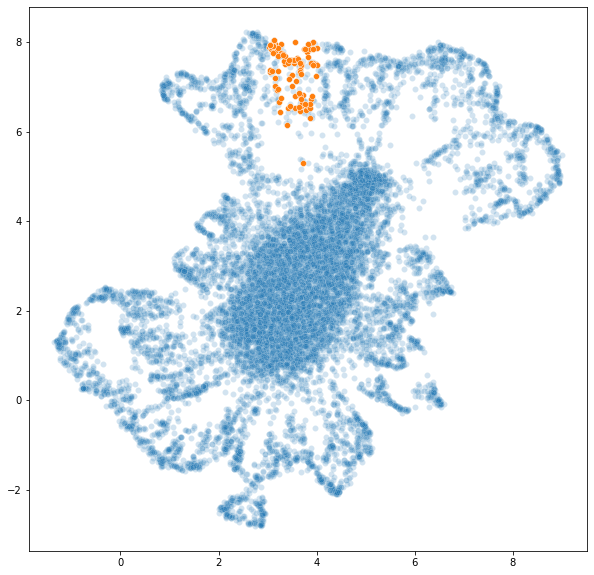

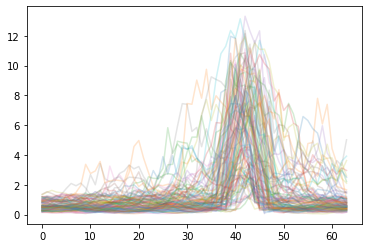

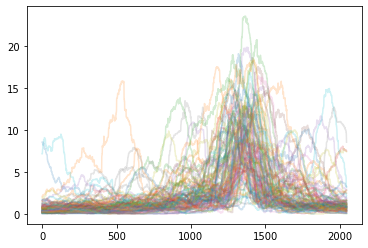

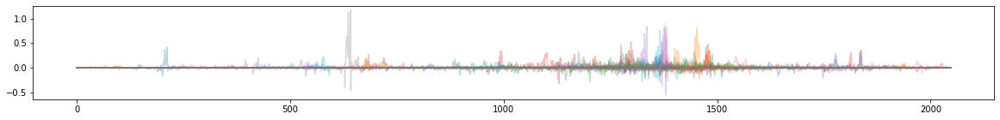

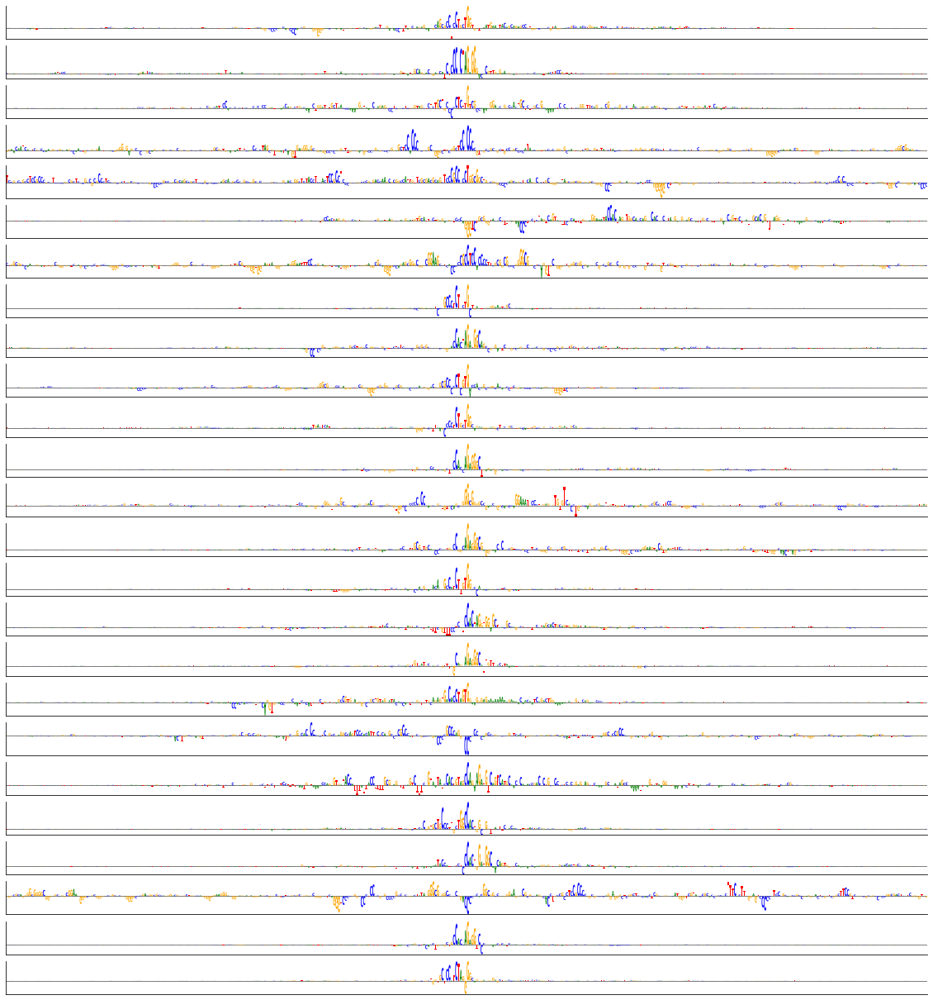

In [ ]:
index = np.where((y > 5)&(x < 4)&(x>3))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


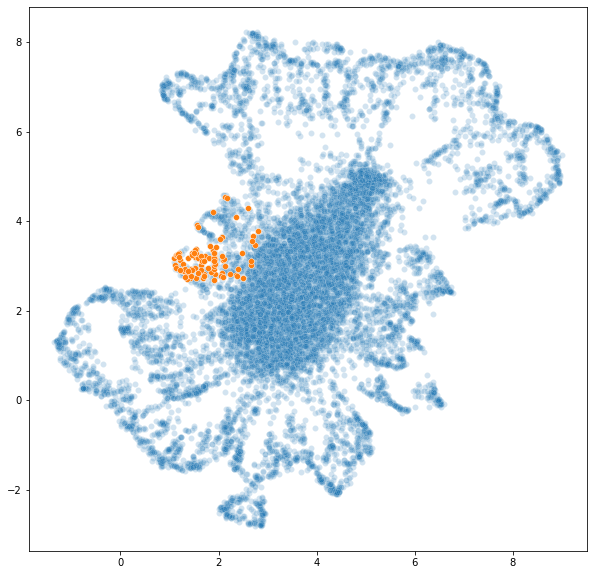

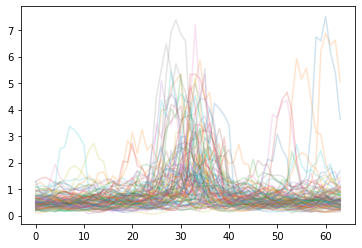

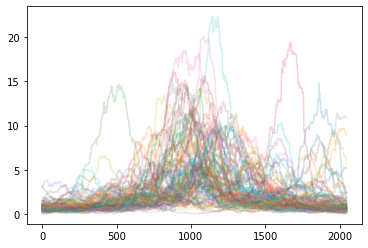

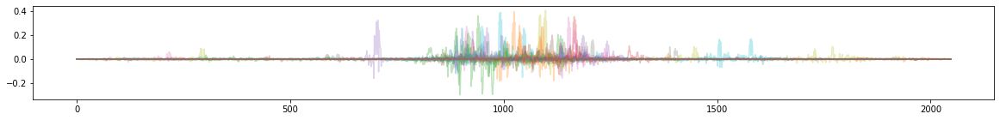

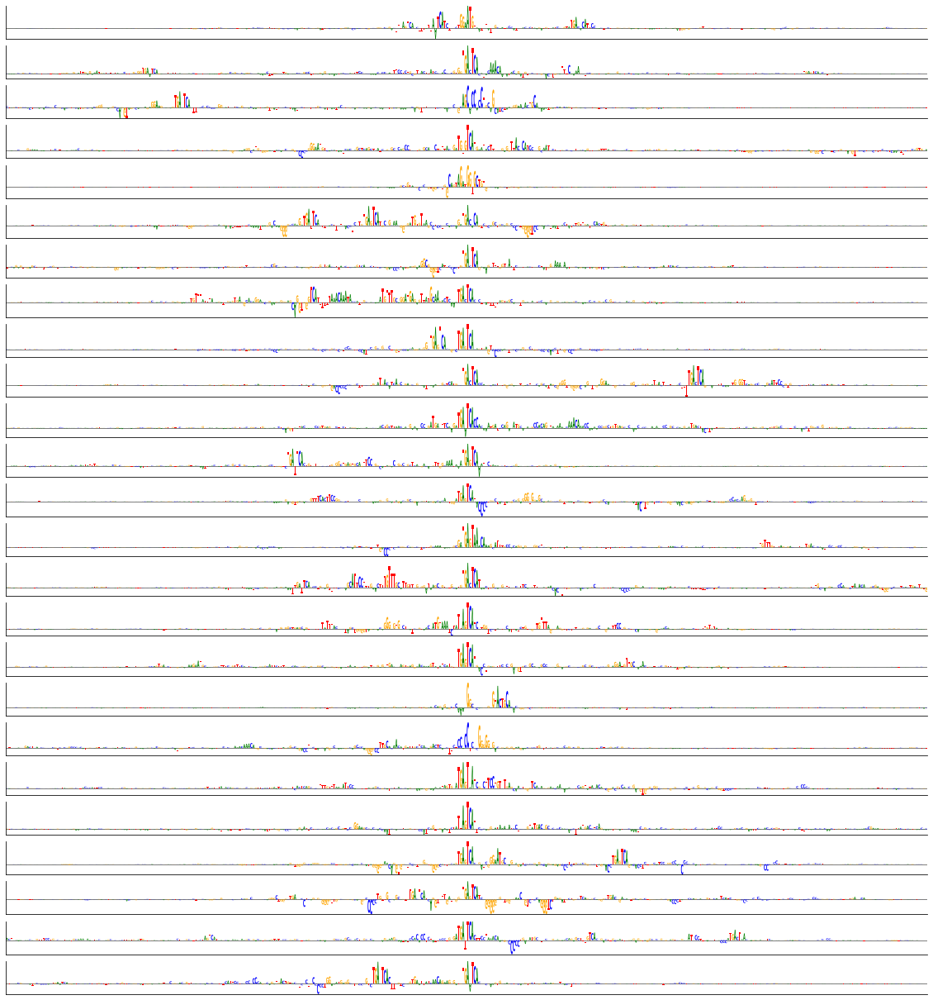

In [ ]:
index = np.where((y > 2.7)&(y < 5)&(x < 2.8))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


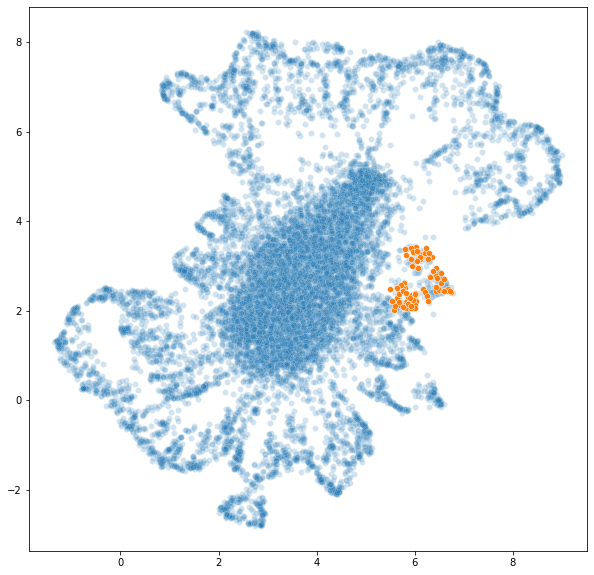

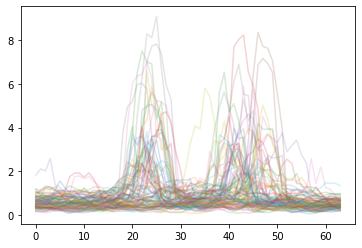

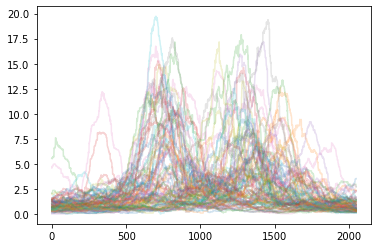

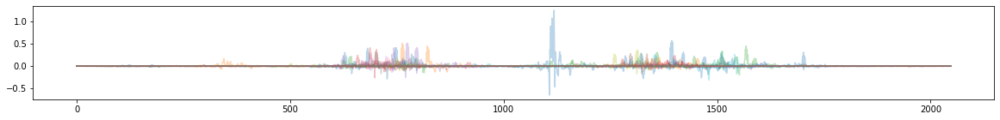

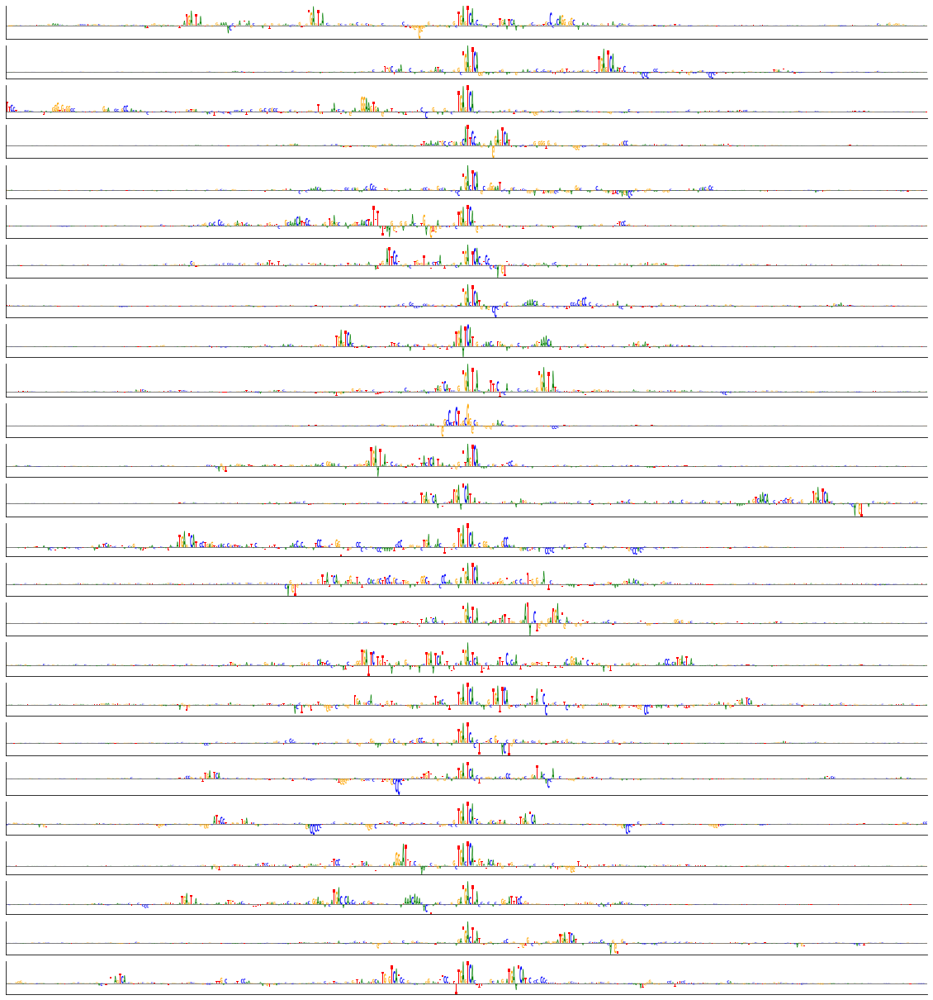

In [ ]:

index = np.where((y > 2)&(y < 3.8)&(x > 5.5))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


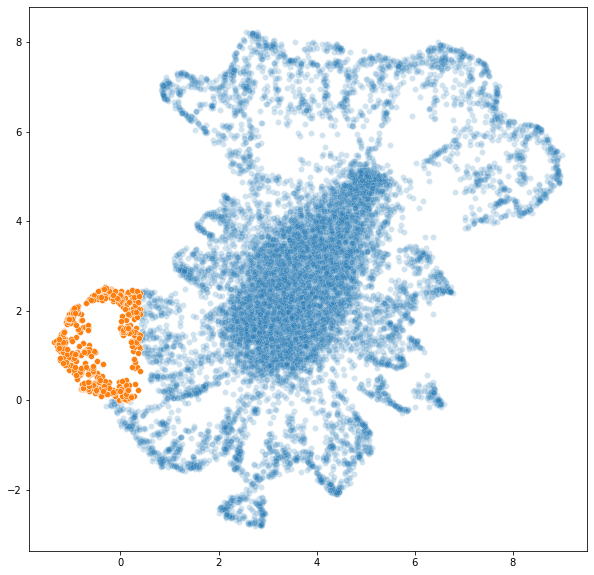

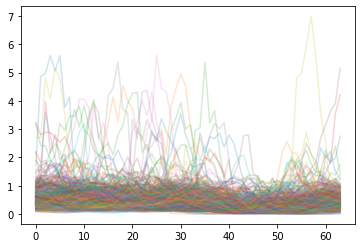

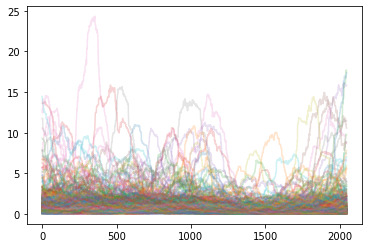

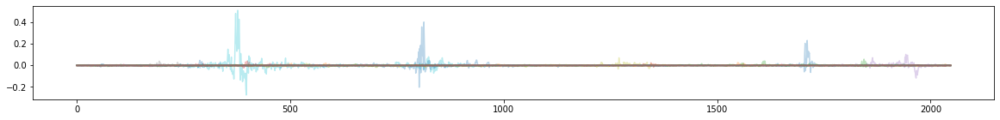

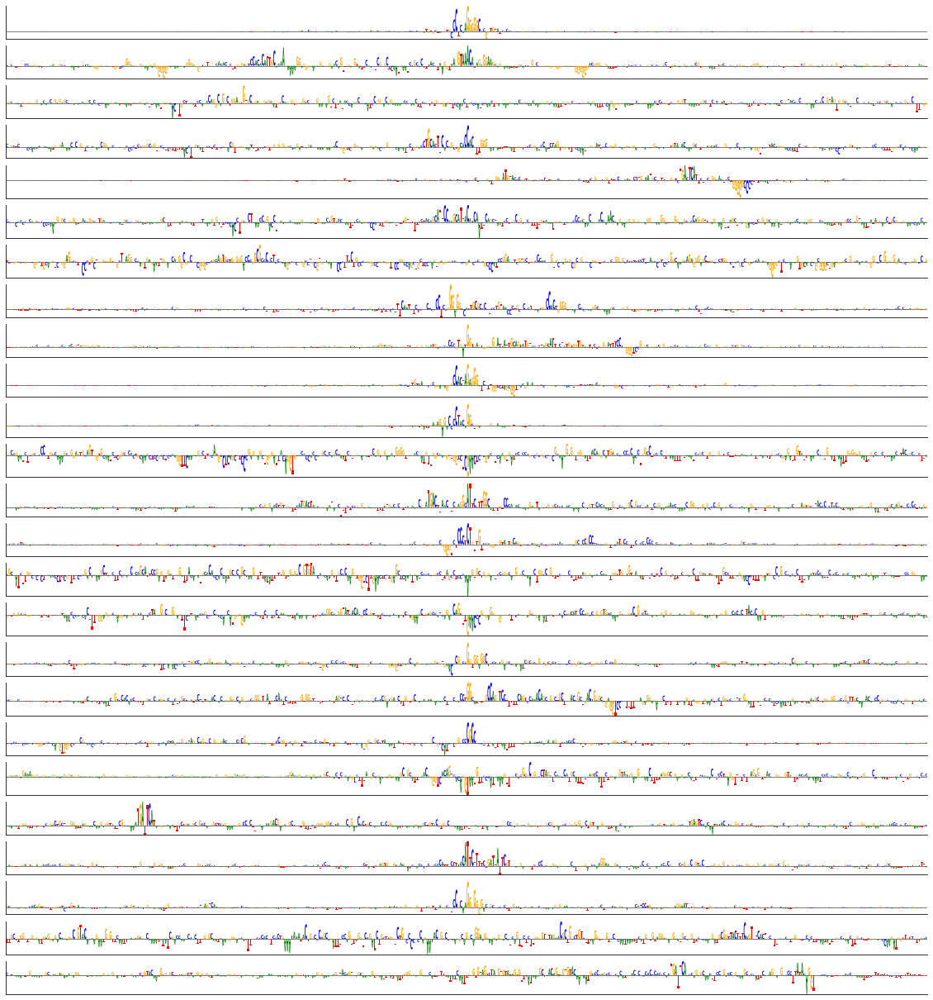

In [ ]:
cluster_index = np.where((y > 0)&(x < 0.4))[0]


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)




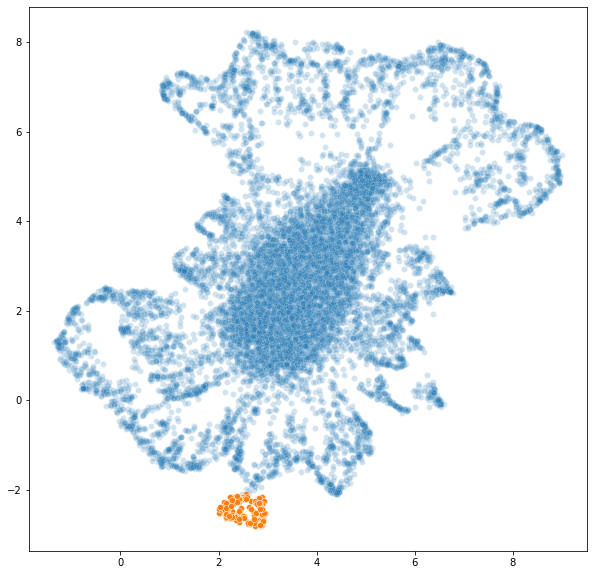

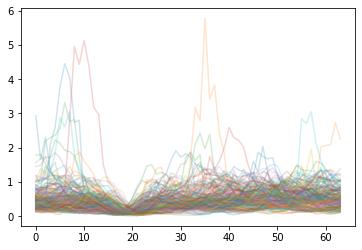

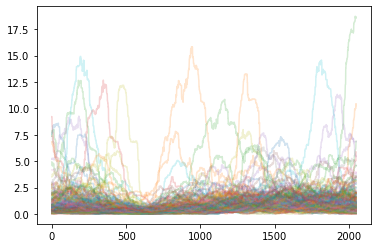

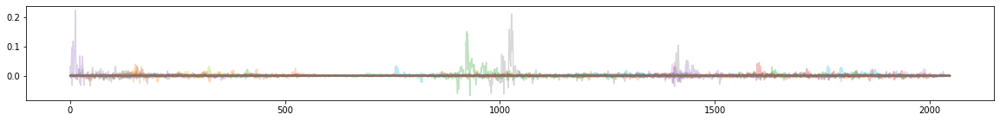

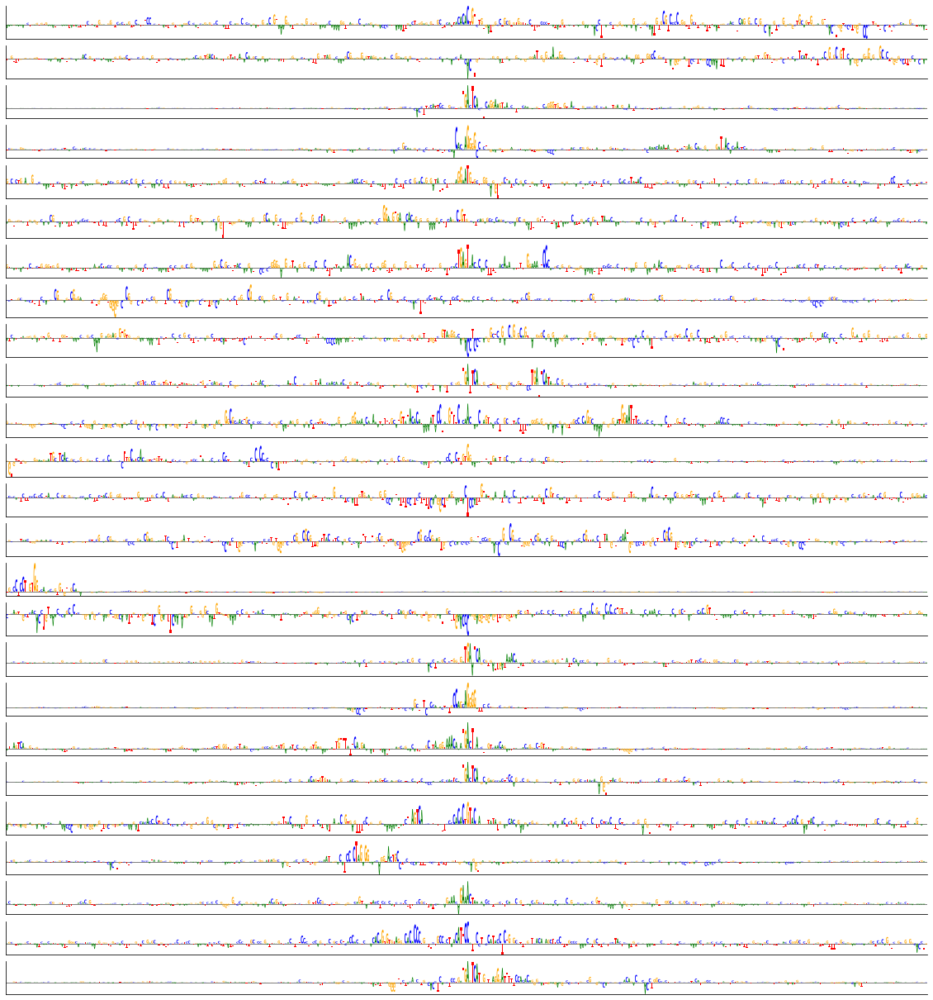

In [ ]:
cluster_index = np.where((y < -2.1))[0]

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


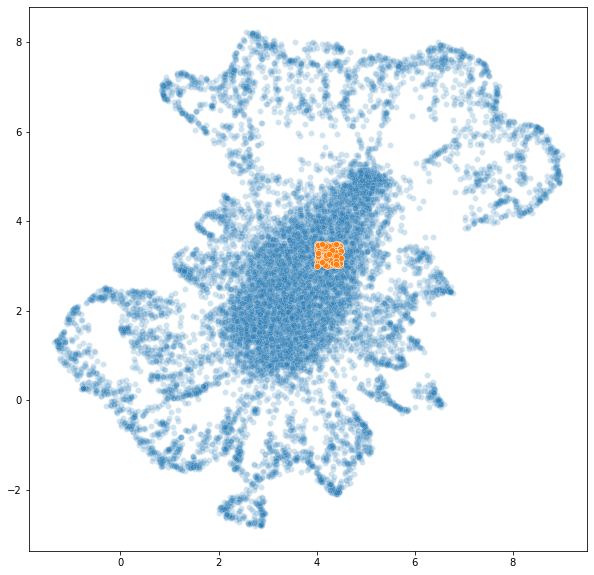

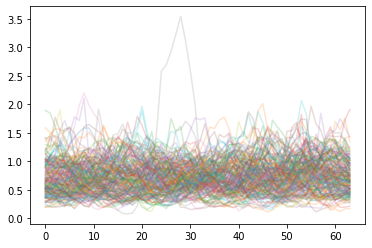

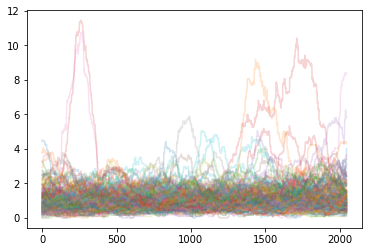

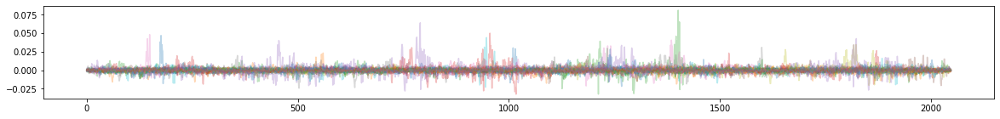

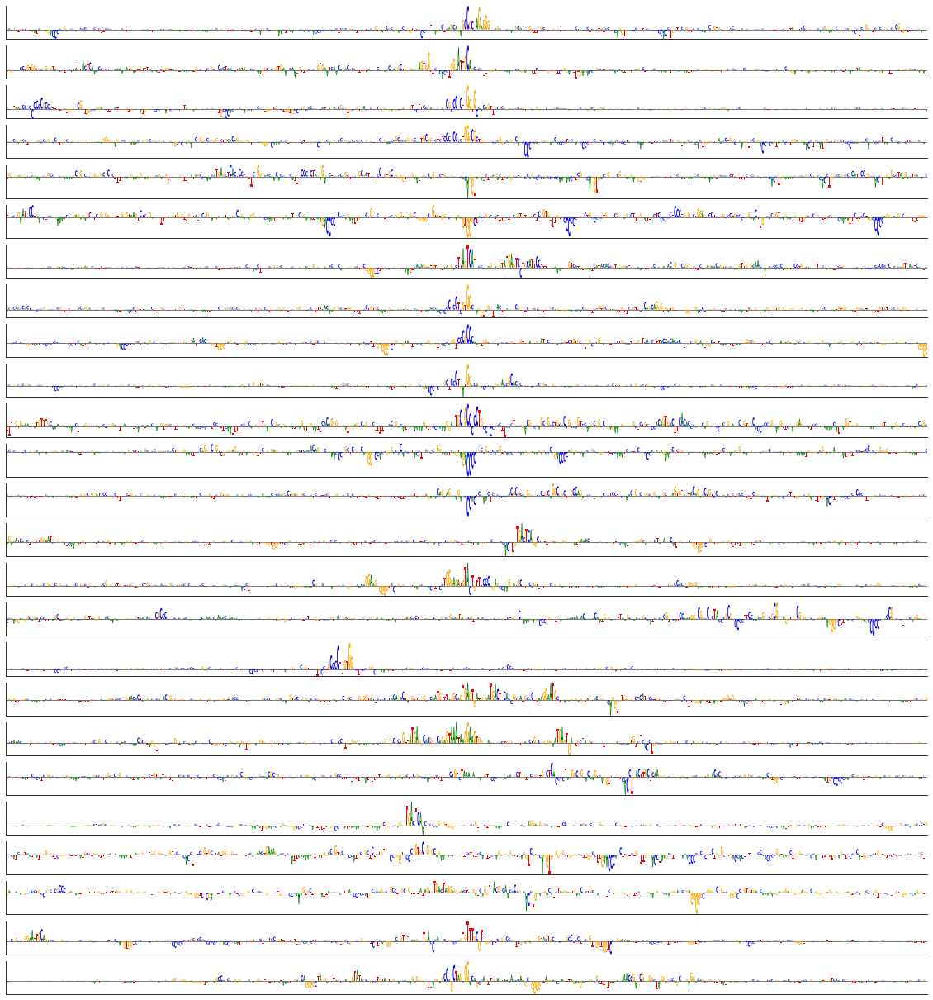

In [ ]:
cluster_index = np.where((y < 3.5)&(y > 3)&(x < 4.5)&(x > 4))[0]

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


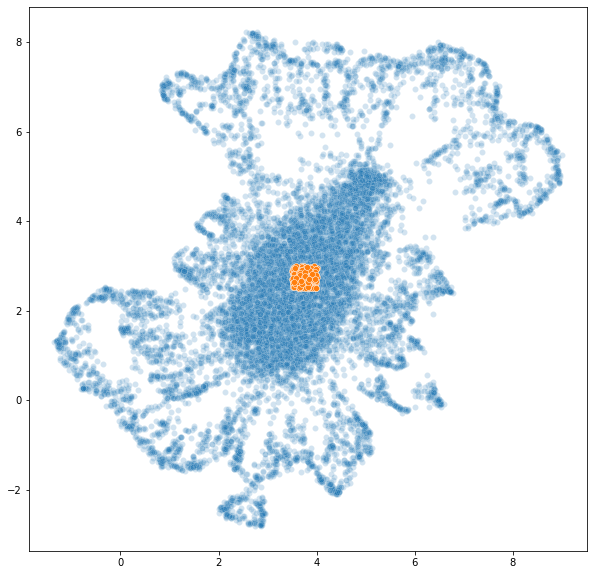

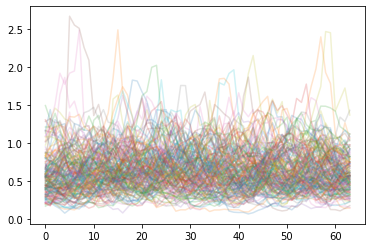

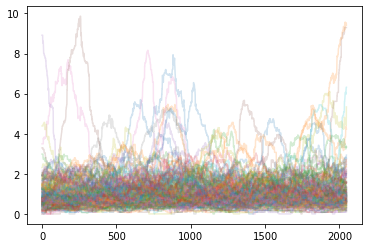

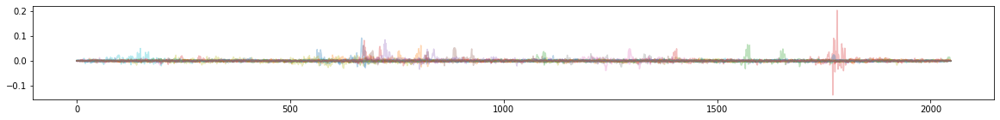

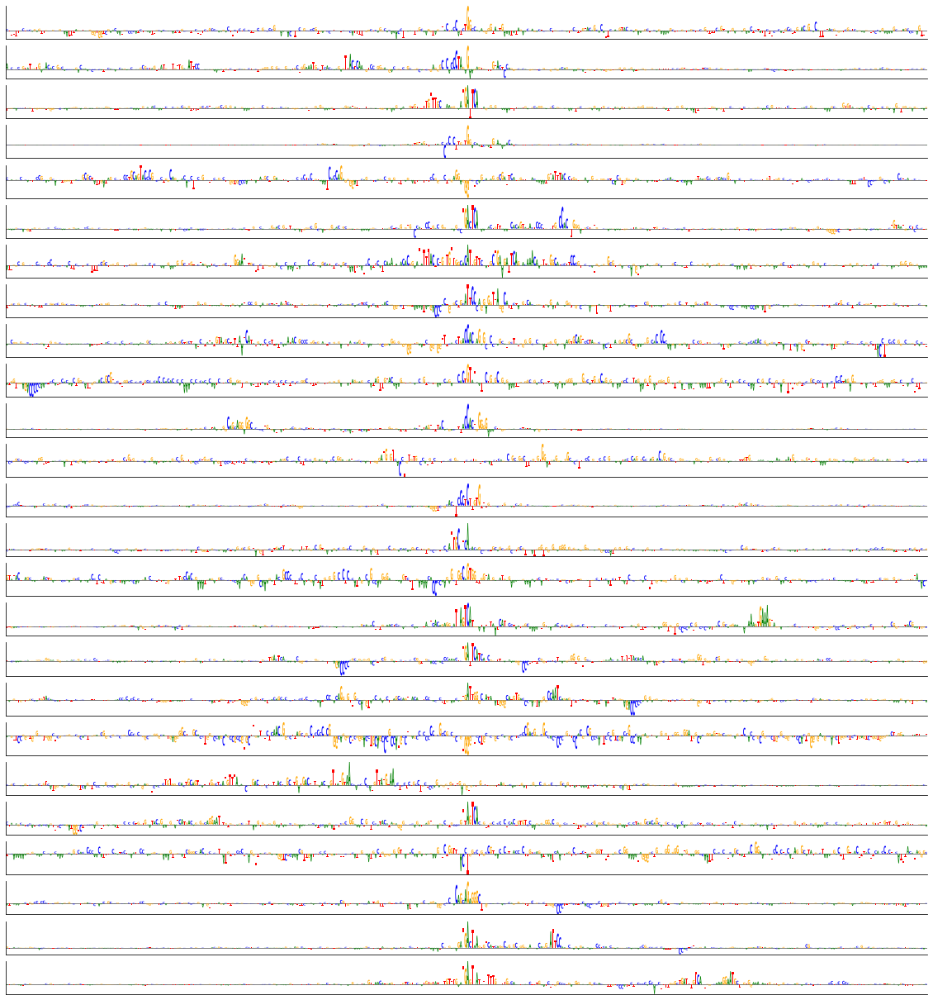

In [ ]:
cluster_index = np.where((y < 3)&(y > 2.5)&(x < 4)&(x > 3.5))[0]

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)

